<a href="https://colab.research.google.com/github/krixhnaprasad/Super-Resolution-of-Satellite-Images/blob/main/main_model_file.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
print("Hello")

Hello


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!unzip "/content/drive/MyDrive/satelite/Copy of train.h5 kaggle.zip"

Archive:  /content/drive/MyDrive/satelite/Copy of train.h5 kaggle.zip
  inflating: train.h5                


In [ ]:
import h5py
import gc
from glob import glob
import numpy as np
from matplotlib import pylab as plt
import cv2
import tensorflow as tf
print(tf.__version__)
from  tensorflow.keras.layers import *
from tensorflow.keras.initializers import *
from tensorflow.keras.optimizers import *
from tensorflow.keras.models import Model
from skimage import exposure
from sklearn.preprocessing import StandardScaler
import time
import os
from sklearn.model_selection import train_test_split
import joblib
from matplotlib import pyplot

2.18.0


In [ ]:
!nvidia-smi


Sat Mar  1 05:28:08 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   41C    P8              9W /   70W |       0MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [ ]:
dataset = h5py.File('/content/train.h5', 'r')
X = dataset["x"]
y = dataset["y"]

X.shape, y.shape

((9245, 256, 256, 6), (9245, 256, 256, 6))

In [ ]:
def contrast(image):
    for band_idx in range(image.shape[-1]):
        band_data = image[:,:,band_idx]
        valid_data = band_data[np.logical_and(band_data != np.inf, band_data != -np.inf)]
        in_low, in_high = np.percentile(valid_data, (2, 98))

        band_data = exposure.rescale_intensity(band_data, in_range=(in_low, in_high))
        image[:,:,band_idx] = band_data

    return image

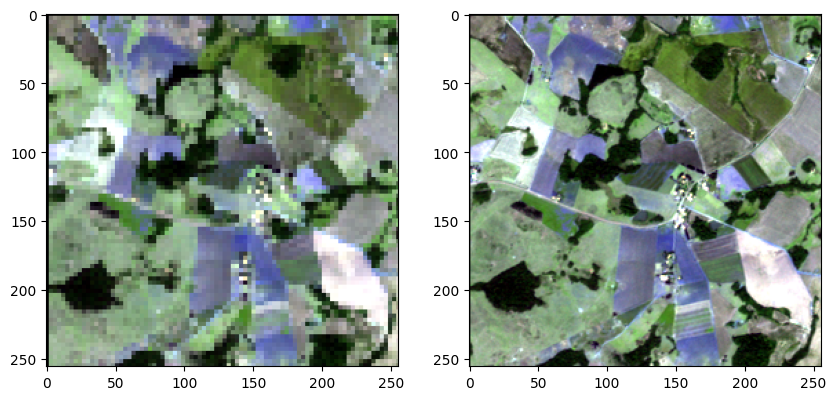

In [ ]:

fig, axs = plt.subplots(1, 2, figsize=(10, 8))

axs[0].imshow(contrast(X[0][:,:, :3] / 10000))
axs[1].imshow(contrast(y[0][:,:, :3] / 10000))

In [ ]:
def load_data(batch_size):
    i=np.random.randint(0,int(len(X)/batch_size))

    img_A=(np.array(X[i:i+batch_size]) / 5000.0) - 1
    img_B=(np.array(y[i:i+batch_size]) / 5000.0) - 1

    return img_A,img_B

def load_batch(batch_size):

    for i in range(int(len(X)/batch_size)):
        img_A=(X[i:i+batch_size] / 5000.0) - 1
        img_B=(y[i:i+batch_size] / 5000.0) - 1

        yield img_A,img_B

In [ ]:
def define_discriminator(image_shape):
    # weight initialization
    init = RandomNormal(stddev=0.02)
    # source image input
    in_src_image = Input(shape=image_shape)
    # target image input
    in_target_image = Input(shape=image_shape)
    # concatenate images channel-wise
    merged = Concatenate()([in_src_image, in_target_image])
    # C64
    d = Conv2D(64, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(merged)
    d = LeakyReLU(alpha=0.2)(d)
    # C128
    d = Conv2D(128, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(d)
    d = BatchNormalization()(d)
    d = LeakyReLU(alpha=0.2)(d)
    # C256
    d = Conv2D(256, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(d)
    d = BatchNormalization()(d)
    d = LeakyReLU(alpha=0.2)(d)
    # C512
    d = Conv2D(512, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(d)
    d = BatchNormalization()(d)
    d = LeakyReLU(alpha=0.2)(d)
    # second last output layer
    d = Conv2D(512, (4,4), padding='same', kernel_initializer=init)(d)
    d = BatchNormalization()(d)
    d = LeakyReLU(alpha=0.2)(d)
    # patch output
    d = Conv2D(1, (4,4), padding='same', kernel_initializer=init)(d)
    patch_out = Activation('sigmoid')(d)
    # define model
    model = Model([in_src_image, in_target_image], patch_out)
    # compile model
    opt = Adam(learning_rate=0.0002, beta_1=0.5)
    model.compile(loss='binary_crossentropy', optimizer=opt, loss_weights=[0.5])
    return model

In [ ]:
def define_encoder_block(layer_in, n_filters, batchnorm=True):
    # weight initialization
    init = RandomNormal(stddev=0.02)
    # add downsampling layer
    g = Conv2D(n_filters, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(layer_in)
    # conditionally add batch normalization
    if batchnorm:
        g = BatchNormalization()(g, training=True)
    # leaky relu activation
    g = LeakyReLU(alpha=0.2)(g)
    return g

# define a decoder block
def decoder_block(layer_in, skip_in, n_filters, dropout=True):
    # weight initialization
    init = RandomNormal(stddev=0.02)
    # add upsampling layer
    g = Conv2DTranspose(n_filters, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(layer_in)
    # add batch normalization
    g = BatchNormalization()(g, training=True)
    # conditionally add dropout
    if dropout:
        g = Dropout(0.5)(g, training=True)
    # merge with skip connection
    g = Concatenate()([g, skip_in])
    # relu activation
    g = Activation('relu')(g)
    return g

# define the standalone generator model
def define_generator(image_shape):
    # weight initialization
    init = RandomNormal(stddev=0.02)
    # image input
    in_image = Input(shape=image_shape)
    # encoder model
    e1 = define_encoder_block(in_image, 64, batchnorm=False)
    e2 = define_encoder_block(e1, 128)
    e3 = define_encoder_block(e2, 256)
    e4 = define_encoder_block(e3, 512)
    e5 = define_encoder_block(e4, 512)
    e6 = define_encoder_block(e5, 512)
    e7 = define_encoder_block(e6, 512)
    # bottleneck, no batch norm and relu
    b = Conv2D(512, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(e7)
    b = Activation('relu')(b)
    # decoder model
    d1 = decoder_block(b, e7, 512)
    d2 = decoder_block(d1, e6, 512)
    d3 = decoder_block(d2, e5, 512)
    d4 = decoder_block(d3, e4, 512, dropout=False)
    d5 = decoder_block(d4, e3, 256, dropout=False)
    d6 = decoder_block(d5, e2, 128, dropout=False)
    d7 = decoder_block(d6, e1, 64, dropout=False)
    # output
    g = Conv2DTranspose(image_shape[-1], (4,4), strides=(2,2), padding='same', kernel_initializer=init)(d7)
    out_image = Activation('tanh')(g)
    # define model
    model = Model(in_image, out_image)
    return model

In [ ]:
def define_gan(g_model, d_model, image_shape):
    # make weights in the discriminator not trainable
    for layer in d_model.layers:
        if not isinstance(layer, BatchNormalization):
            layer.trainable = False
    # define the source image
    in_src = Input(shape=image_shape)
    # connect the source image to the generator input
    gen_out = g_model(in_src)
    # connect the source input and generator output to the discriminator input
    dis_out = d_model([in_src, gen_out])
    # src image as input, generated image and classification output
    model = Model(in_src, [dis_out, gen_out])
    # compile model
    opt = Adam(learning_rate=0.0002, beta_1=0.5)
    model.compile(loss=['binary_crossentropy', 'mae'], optimizer=opt, loss_weights=[1,100])
    return model

In [ ]:
# select a batch of random samples, returns images and target
def generate_real_samples(n_samples, patch_shape):
    # unpack dataset
    trainA, trainB = load_data(n_samples)
    # choose random instances
    ix = np.random.randint(0, trainA.shape[0], n_samples)
    # retrieve selected images
    X1, X2 = trainA[ix], trainB[ix]
    # generate 'real' class labels (1)
    y = np.ones((n_samples, patch_shape, patch_shape, 1))
    return [X1, X2], y

In [ ]:
# generate a batch of images, returns images and targets
def generate_fake_samples(g_model, samples, patch_shape):
    # generate fake instance
    X = g_model.predict(samples)
    # create 'fake' class labels (0)
    y = np.zeros((len(X), patch_shape, patch_shape, 1))
    return X, y

In [ ]:
def summarize_performance(step, g_model, logs_dir, n_samples):
    r, c = 3, n_samples

    # select a sample of input images
    [X_realA, X_realB], _ = generate_real_samples(n_samples, 1)

    # generate a batch of fake samples
    X_fakeB, _ = generate_fake_samples(g_model, X_realA, 1)

    gen_imgs = np.concatenate([X_realA, X_fakeB, X_realB])

    titles = ['Condition', 'Generated', 'Original']
    fig, axs = plt.subplots(r, c, figsize=(20,20))
    cnt = 0
    for i in range(r):
        for j in range(c):
            image = gen_imgs[cnt]

            reescaled_image = (image + 1) * 5000

            rgb_image = reescaled_image[:,:, :3]

            axs[i,j].imshow(contrast(rgb_image/10000))
            axs[i,j].set_title(titles[i])
            axs[i,j].axis('off')
            cnt += 1

    filename = '%s/plot_%06d.png' % (logs_dir, step)
    fig.savefig(filename)
    plt.show()

In [ ]:
# train pix2pix model
def train(d_model, g_model, gan_model, n_epochs, n_batch, logs_dir, d_filename, g_filename):

    # determine the output square shape of the discriminator
    n_patch = d_model.output_shape[1]

    # unpack dataset
    for epoch in range(1, n_epochs + 1):
        for batch_i,(trainA,trainB) in enumerate(load_batch(n_batch)):

            # select a batch of real samples
            [X_realA, X_realB], y_real = generate_real_samples(n_batch, n_patch)

            # generate a batch of fake samples
            X_fakeB, y_fake = generate_fake_samples(g_model, X_realA, n_patch)

            # update discriminator for real samples
            d_loss1 = d_model.train_on_batch([X_realA, X_realB], y_real)

            # update discriminator for generated samples
            d_loss2 = d_model.train_on_batch([X_realA, X_fakeB], y_fake)

            # update the generator
            g_loss, _, _ = gan_model.train_on_batch(X_realA, [y_real, X_realB])

            # summarize performance
            print(f'[Epoch {epoch}] [Batch {batch_i}] [D1 loss: {d_loss1}] [D2 loss: {d_loss2}] [G loss: {g_loss}]')

        # summarize model performance
        summarize_performance(epoch, g_model, logs_dir, n_samples=3)
        # save the generator model
        g_model.save(g_filename)

        # save the discriminator model
        d_model.save(d_filename)

/usr/local/lib/python3.11/dist-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


1/1 ━━━━━━━━━━━━━━━━━━━━ 13s 13s/step
[Epoch 1] [Batch 0] [D1 loss: 0.332638680934906] [D2 loss: 0.42478063702583313] [G loss: 72.87712860107422]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step
[Epoch 1] [Batch 1] [D1 loss: 0.39350709319114685] [D2 loss: 0.4234260022640228] [G loss: 71.17559814453125]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step
[Epoch 1] [Batch 2] [D1 loss: 0.4055444598197937] [D2 loss: 0.4254850149154663] [G loss: 69.2696533203125]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step
[Epoch 1] [Batch 3] [D1 loss: 0.41240039467811584] [D2 loss: 0.4263435900211334] [G loss: 67.7045669555664]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step
[Epoch 1] [Batch 4] [D1 loss: 0.4150671362876892] [D2 loss: 0.42516669631004333] [G loss: 66.37556457519531]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step
[Epoch 1] [Batch 5] [D1 loss: 0.41644737124443054] [D2 loss: 0.42489561438560486] [G loss: 64.59479522705078]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step
[Epoch 1] [Batch 6] [D1 loss: 0.41761690378189087] [D2 loss: 0.42486461997032

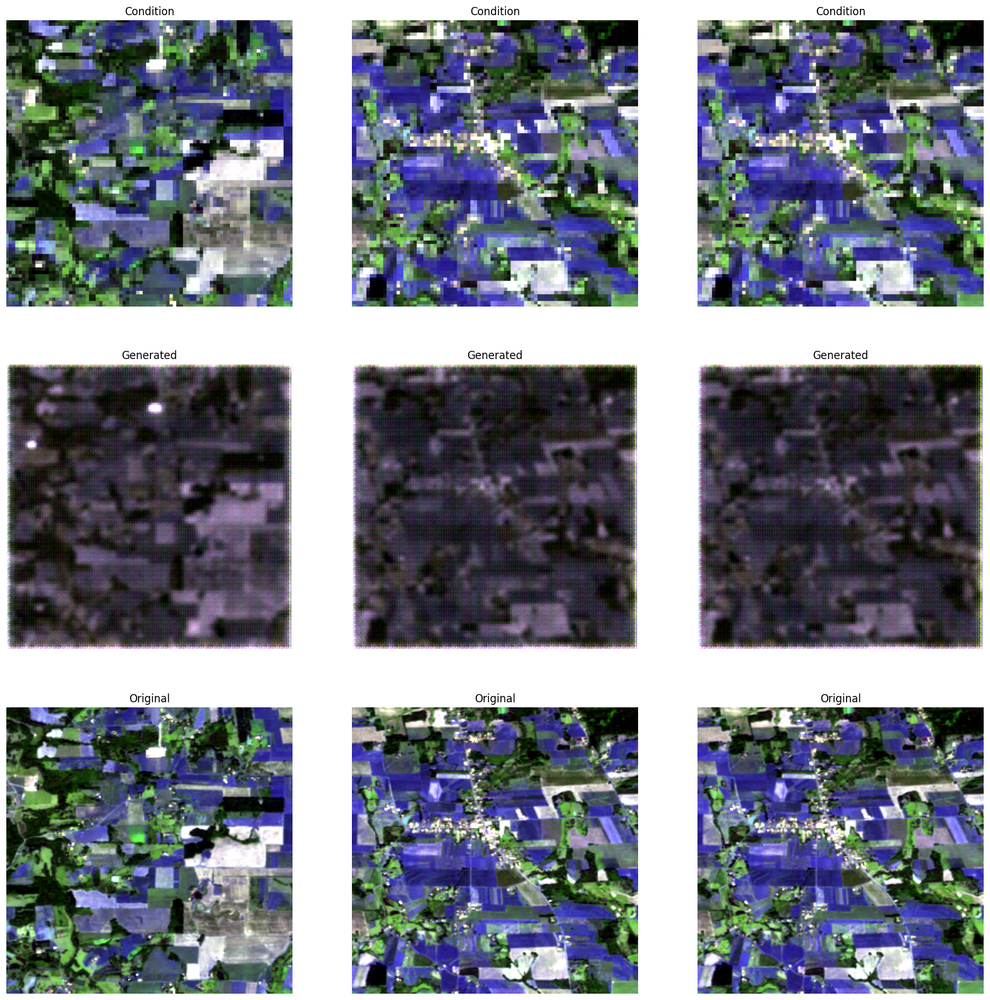

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step
[Epoch 2] [Batch 0] [D1 loss: 0.4374096691608429] [D2 loss: 0.4378587603569031] [G loss: 5.981088638305664]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step
[Epoch 2] [Batch 1] [D1 loss: 0.4374544620513916] [D2 loss: 0.4378988742828369] [G loss: 5.968999862670898]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step
[Epoch 2] [Batch 2] [D1 loss: 0.4374980330467224] [D2 loss: 0.4379538297653198] [G loss: 5.9568281173706055]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step
[Epoch 2] [Batch 3] [D1 loss: 0.43755555152893066] [D2 loss: 0.43799835443496704] [G loss: 5.944320201873779]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step
[Epoch 2] [Batch 4] [D1 loss: 0.43759897351264954] [D2 loss: 0.4380471706390381] [G loss: 5.932072639465332]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step
[Epoch 2] [Batch 5] [D1 loss: 0.43764859437942505] [D2 loss: 0.4381002187728882] [G loss: 5.919790744781494]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step
[Epoch 2] [Batch 6] [D1 loss: 0.43770429491996765] [D2 loss: 0.43815845251

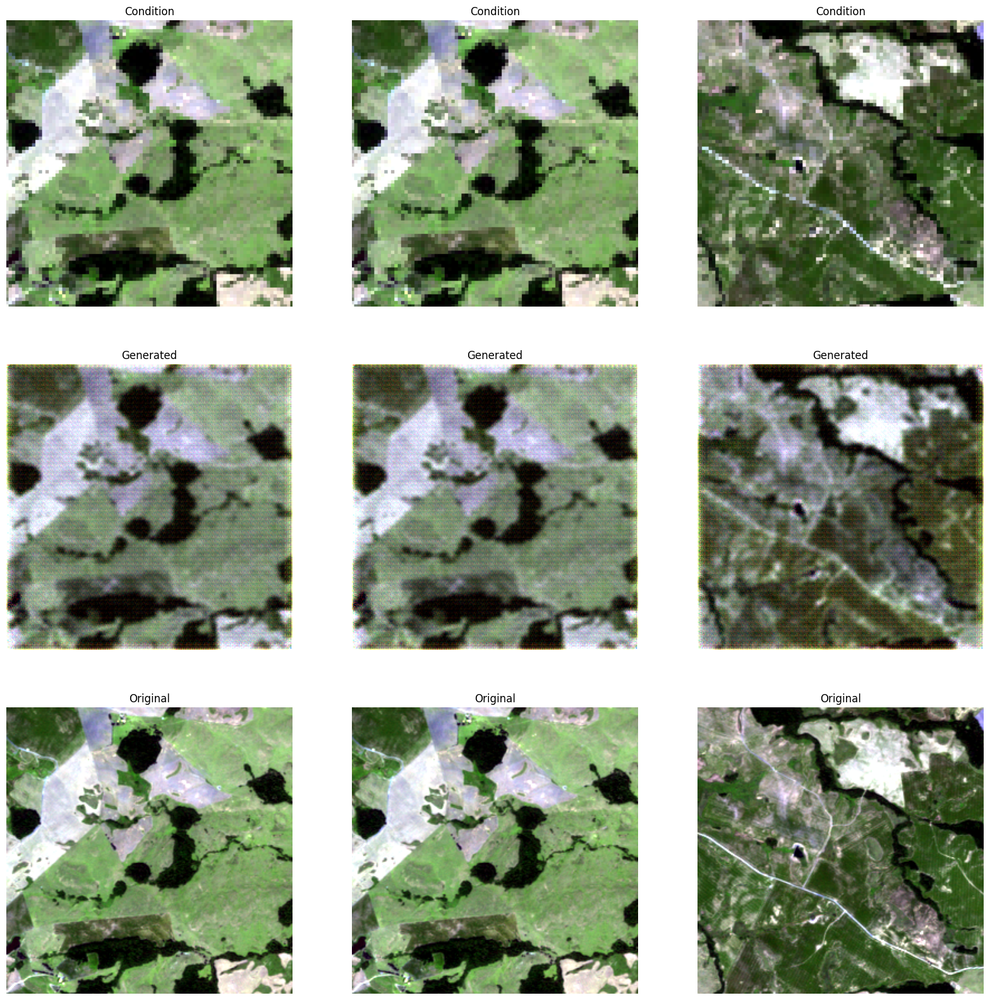

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step
[Epoch 3] [Batch 0] [D1 loss: 0.4532552659511566] [D2 loss: 0.453544944524765] [G loss: 4.160105228424072]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step
[Epoch 3] [Batch 1] [D1 loss: 0.45331010222435] [D2 loss: 0.453587144613266] [G loss: 4.156822204589844]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step
[Epoch 3] [Batch 2] [D1 loss: 0.4533502459526062] [D2 loss: 0.4536415934562683] [G loss: 4.153675556182861]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step
[Epoch 3] [Batch 3] [D1 loss: 0.45340725779533386] [D2 loss: 0.4536912143230438] [G loss: 4.1505632400512695]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step
[Epoch 3] [Batch 4] [D1 loss: 0.45345720648765564] [D2 loss: 0.4537470042705536] [G loss: 4.146790504455566]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step
[Epoch 3] [Batch 5] [D1 loss: 0.4535142481327057] [D2 loss: 0.4537973403930664] [G loss: 4.143964767456055]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step
[Epoch 3] [Batch 6] [D1 loss: 0.45356622338294983] [D2 loss: 0.4538503587245941]

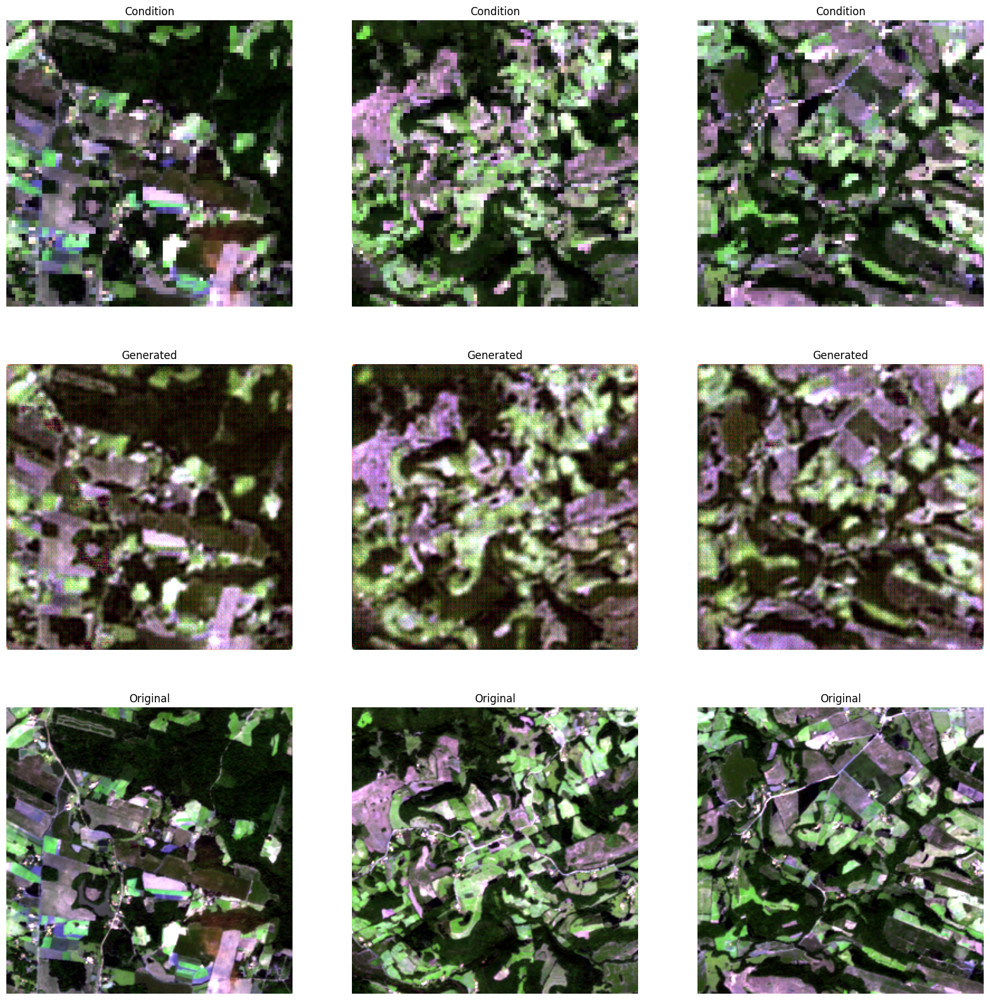

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step
[Epoch 4] [Batch 0] [D1 loss: 0.46421369910240173] [D2 loss: 0.4644099175930023] [G loss: 3.498767614364624]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step
[Epoch 4] [Batch 1] [D1 loss: 0.4642394483089447] [D2 loss: 0.46443483233451843] [G loss: 3.497093915939331]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step
[Epoch 4] [Batch 2] [D1 loss: 0.4642643630504608] [D2 loss: 0.46445825695991516] [G loss: 3.4956703186035156]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step
[Epoch 4] [Batch 3] [D1 loss: 0.4642884433269501] [D2 loss: 0.4644872844219208] [G loss: 3.4937474727630615]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step
[Epoch 4] [Batch 4] [D1 loss: 0.4643181264400482] [D2 loss: 0.4645109474658966] [G loss: 3.4925339221954346]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step
[Epoch 4] [Batch 5] [D1 loss: 0.4643413722515106] [D2 loss: 0.4645366370677948] [G loss: 3.490902900695801]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step
[Epoch 4] [Batch 6] [D1 loss: 0.4643678665161133] [D2 loss: 0.46456634998

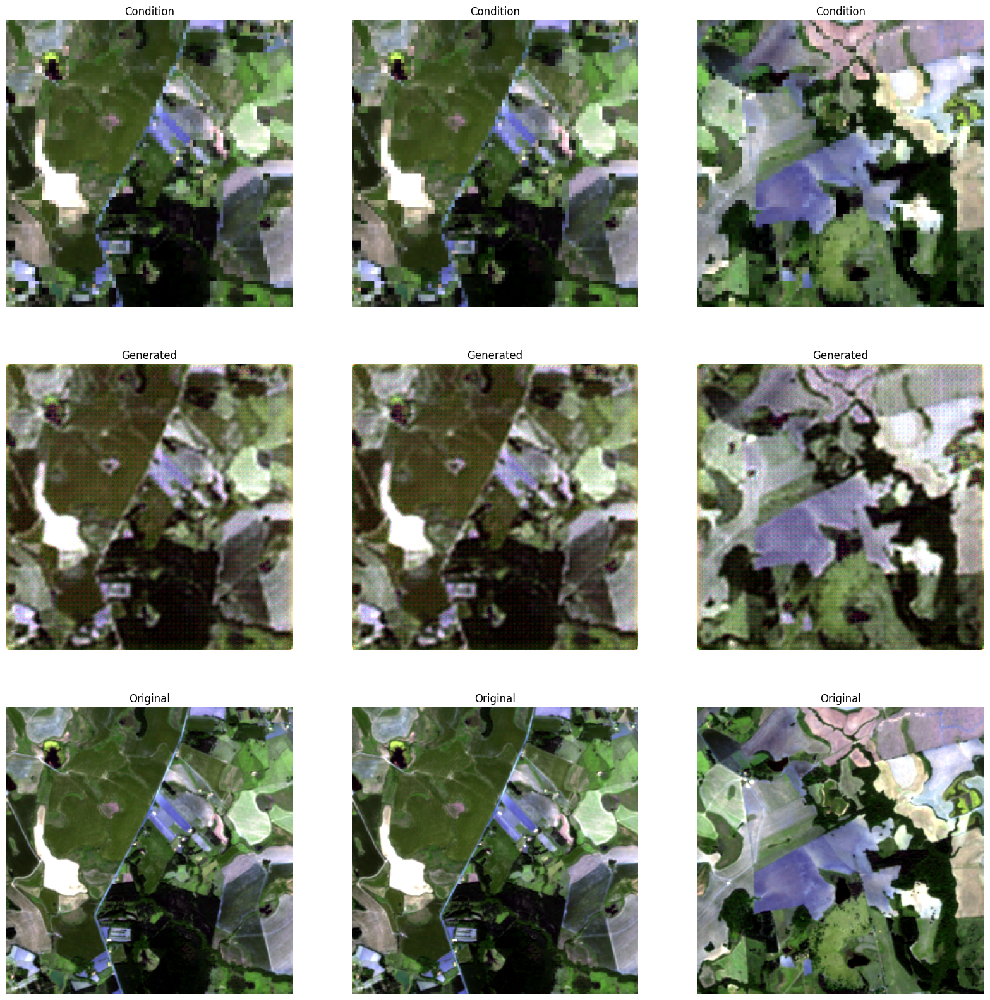

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step
[Epoch 5] [Batch 0] [D1 loss: 0.4698970317840576] [D2 loss: 0.4700431823730469] [G loss: 3.1422715187072754]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step
[Epoch 5] [Batch 1] [D1 loss: 0.4699093699455261] [D2 loss: 0.4700552821159363] [G loss: 3.141427755355835]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step
[Epoch 5] [Batch 2] [D1 loss: 0.46992096304893494] [D2 loss: 0.4700665771961212] [G loss: 3.1404755115509033]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step
[Epoch 5] [Batch 3] [D1 loss: 0.46993330121040344] [D2 loss: 0.47008436918258667] [G loss: 3.1395103931427]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step
[Epoch 5] [Batch 4] [D1 loss: 0.4699503183364868] [D2 loss: 0.4701070189476013] [G loss: 3.1384634971618652]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step
[Epoch 5] [Batch 5] [D1 loss: 0.4699740707874298] [D2 loss: 0.47012224793434143] [G loss: 3.1375932693481445]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step
[Epoch 5] [Batch 6] [D1 loss: 0.46998876333236694] [D2 loss: 0.4701345860

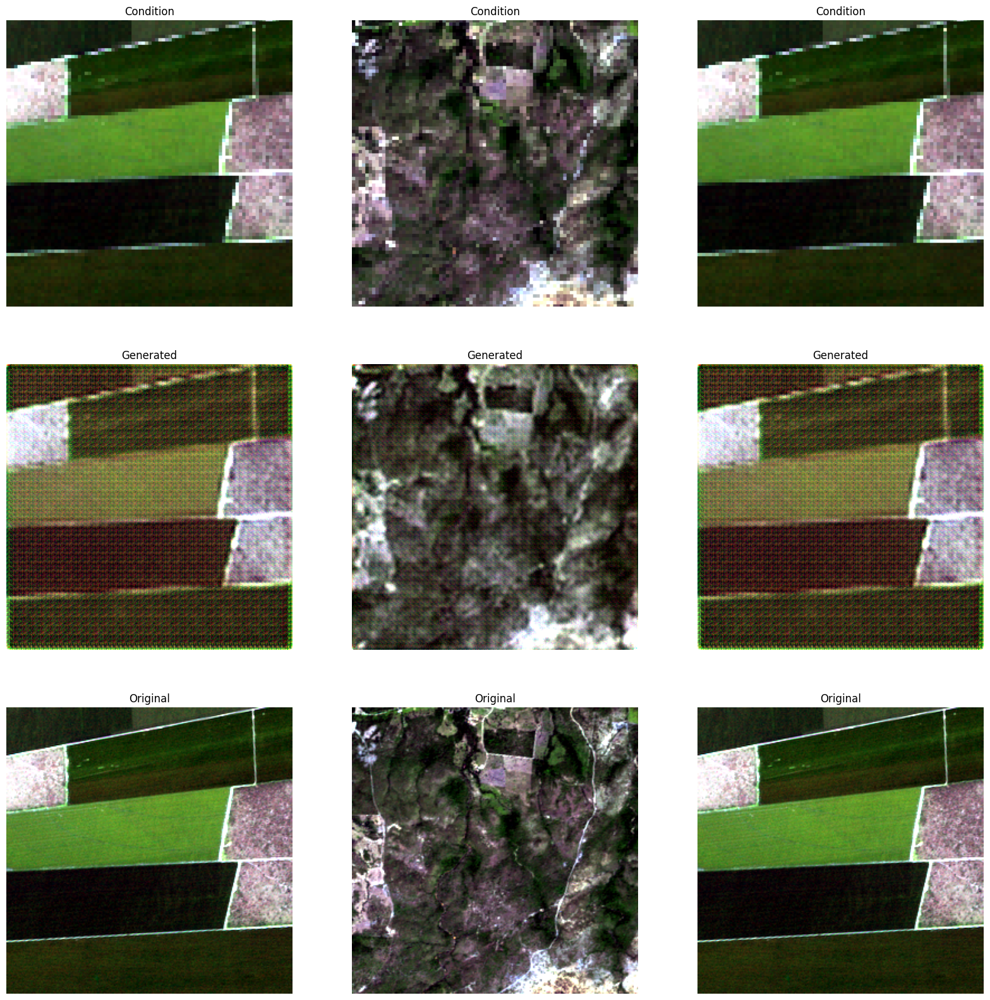

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step
[Epoch 6] [Batch 0] [D1 loss: 0.4729960262775421] [D2 loss: 0.4731151759624481] [G loss: 2.9109487533569336]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step
[Epoch 6] [Batch 1] [D1 loss: 0.47300487756729126] [D2 loss: 0.4731227457523346] [G loss: 2.9104626178741455]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step
[Epoch 6] [Batch 2] [D1 loss: 0.47301265597343445] [D2 loss: 0.47312846779823303] [G loss: 2.9098639488220215]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step
[Epoch 6] [Batch 3] [D1 loss: 0.4730188548564911] [D2 loss: 0.473136842250824] [G loss: 2.909114360809326]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step
[Epoch 6] [Batch 4] [D1 loss: 0.4730273485183716] [D2 loss: 0.4731495678424835] [G loss: 2.908313274383545]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step
[Epoch 6] [Batch 5] [D1 loss: 0.4730391502380371] [D2 loss: 0.47315892577171326] [G loss: 2.9074935913085938]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step
[Epoch 6] [Batch 6] [D1 loss: 0.47304895520210266] [D2 loss: 0.473162531

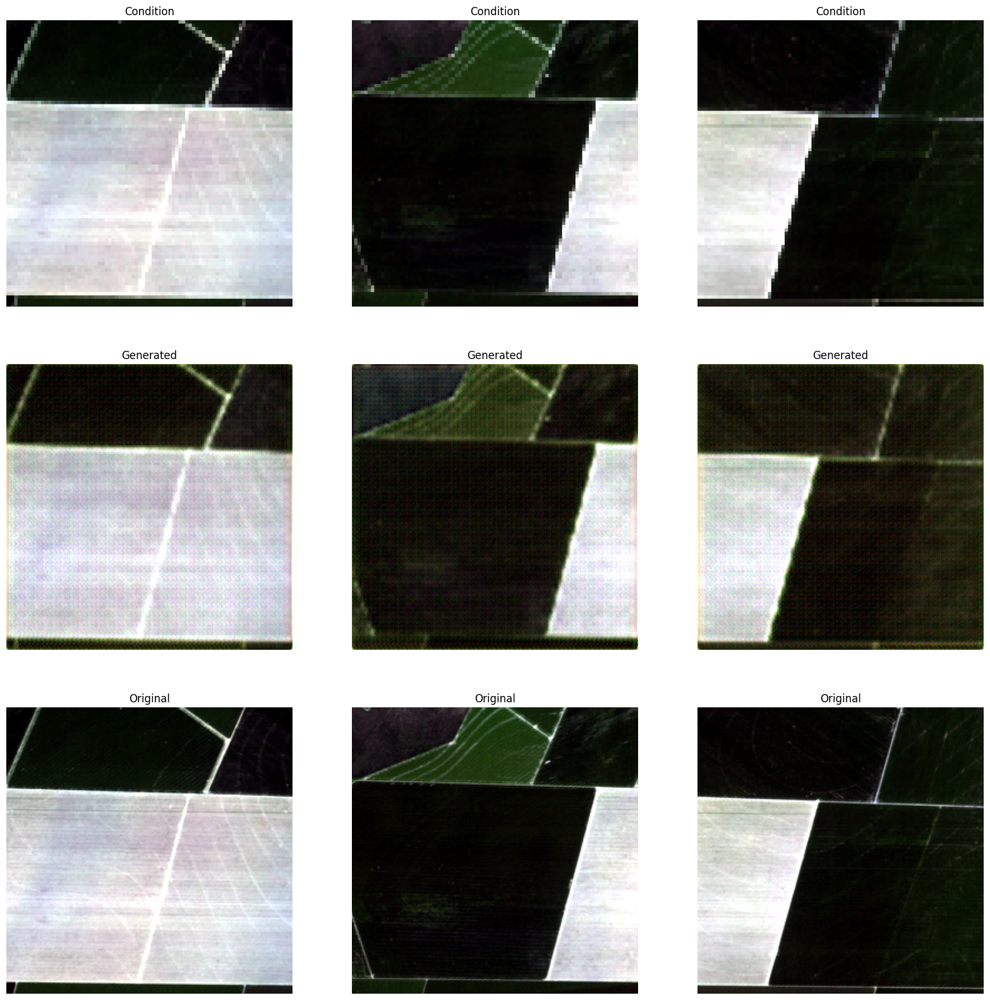

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step
[Epoch 7] [Batch 0] [D1 loss: 0.4749597907066345] [D2 loss: 0.47505810856819153] [G loss: 2.74790096282959]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step
[Epoch 7] [Batch 1] [D1 loss: 0.4749651253223419] [D2 loss: 0.4750613868236542] [G loss: 2.7474865913391113]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step
[Epoch 7] [Batch 2] [D1 loss: 0.47496771812438965] [D2 loss: 0.4750675559043884] [G loss: 2.746845006942749]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step
[Epoch 7] [Batch 3] [D1 loss: 0.4749740958213806] [D2 loss: 0.4750731885433197] [G loss: 2.7463090419769287]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step
[Epoch 7] [Batch 4] [D1 loss: 0.47497931122779846] [D2 loss: 0.4750778377056122] [G loss: 2.745753765106201]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step
[Epoch 7] [Batch 5] [D1 loss: 0.4749847650527954] [D2 loss: 0.4750785827636719] [G loss: 2.7452552318573]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step
[Epoch 7] [Batch 6] [D1 loss: 0.47498586773872375] [D2 loss: 0.47507956624031

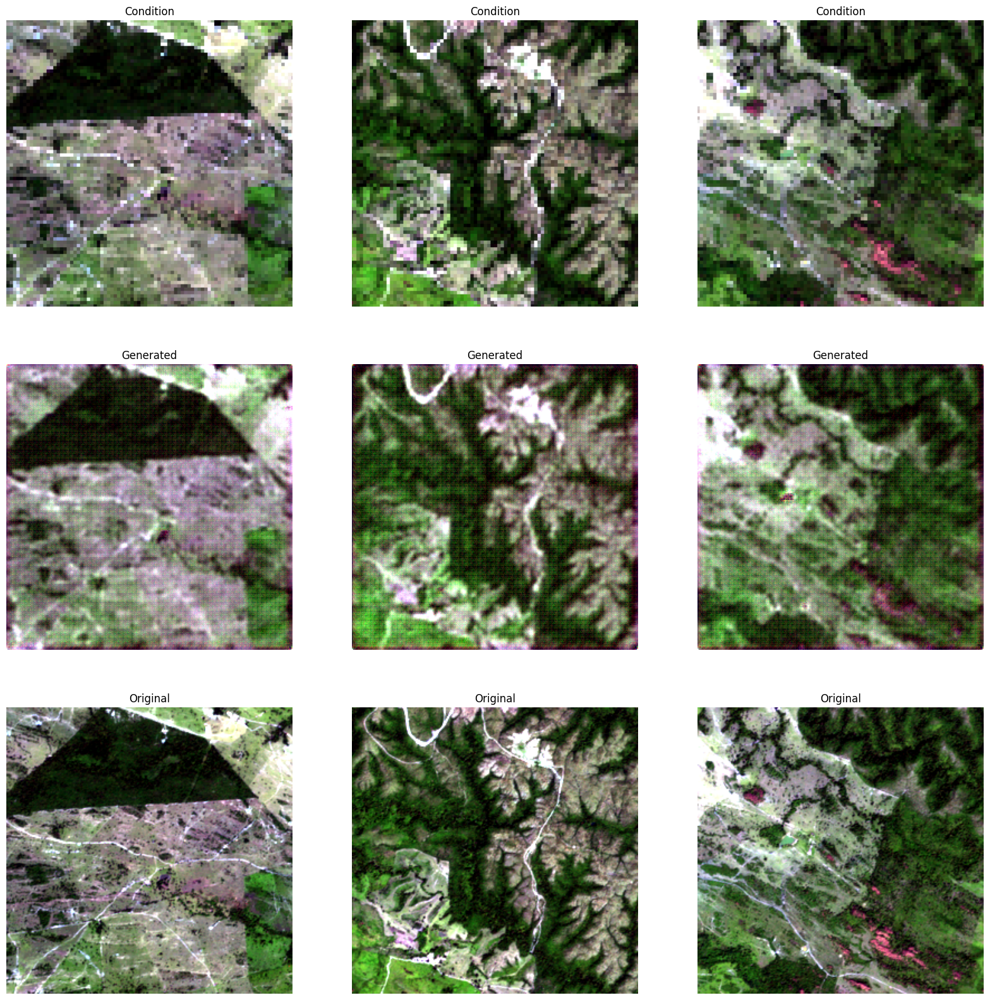

In [ ]:
# load image data
image_shape = (256, 256, 6)

# define the models
d_model = define_discriminator(image_shape)
g_model = define_generator(image_shape)

# save or reload models
logs_dir = '/content/output/'
if not os.path.exists(logs_dir):
    os.mkdir(logs_dir)

g_filename = f'{logs_dir}/g_model.h5'
d_filename = f'{logs_dir}/d_model.h5'

if os.path.exists(g_filename):
    g_model.load_model(g_filename)

if os.path.exists(d_filename):
    d_model.load_model(d_filename)

# define the composite model
gan_model = define_gan(g_model, d_model, image_shape)

# train model
train(d_model, g_model, gan_model, n_epochs=7, n_batch=32,
      logs_dir=logs_dir, d_filename=d_filename, g_filename=g_filename)

In [ ]:
print(X[0].shape)

(256, 256, 6)


In [ ]:
from tensorflow.keras.models import load_model
from PIL import Image
import numpy as np

# Load the trained generator model
model_path = '/content/g_model.h5'  # Replace with the actual path to your saved model
generator = load_model(model_path)


def preprocess_image(image_path):
    # img = Image.open(image_path)
    img = img.resize((256, 256))  # Resize to match the input shape of the model
    img_array = np.array(img) / 5000.0 - 1  # Normalize the image
    img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension
    return img_array

def postprocess_image(img_array):
  img = (img_array + 1) * 5000
  img = np.clip(img, 0, 255).astype(np.uint8)
  img = img.squeeze() # Remove batch dimension and channel dimension if present.
  return Image.fromarray(img)


def predict_super_resolution(image_path):
    # Preprocess the image
    processed_img = preprocess_image(image_path)
    # processed_img = image_path
    # Perform super-resolution prediction
    sr_image = generator.predict(processed_img)

    # Postprocess the image
    sr_image = postprocess_image(sr_image)
    return sr_image

# Example usage
image_path = X[0] # Replace with the path to your input image
sr_image = predict_super_resolution(image_path)
sr_image.save('/content/output.png') # Save the super-resolution image


In [ ]:
import numpy as np
sr_image = generator.predict(np.expand_dims(X[0], axis=0))

1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step


In [ ]:
sr_image = generator.predict(np.expand_dims(contrast(X[100]/5000.0 - 1), axis=0))


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


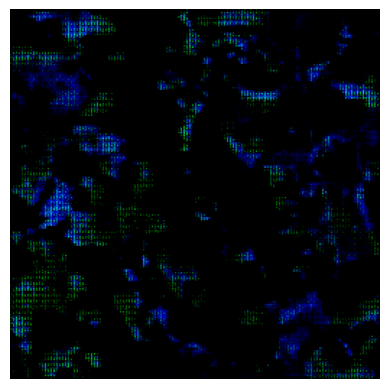

In [ ]:
import matplotlib.pyplot as plt


# If sr_image has shape (1, 256, 256, 6):
sr_image = sr_image[0] # Remove batch dimension


# Display the image using matplotlib
plt.imshow(sr_image[:,:,:3]) # Show only the first 3 channels (RGB) for visualization
plt.axis('off') # Hide axis
plt.show()


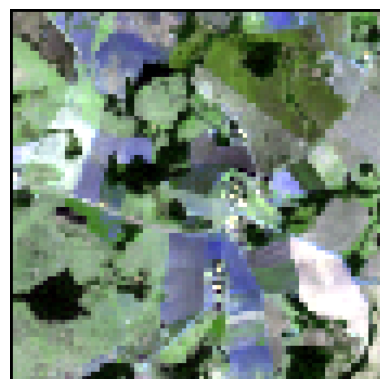

In [ ]:
# If sr_image has shape (1, 256, 256, 6):
sr_image = sr_image[0] # Remove batch dimension


# Display the image using matplotlib
plt.imshow(contrast(X[0][:,:,:3] / 10000)) # Show only the first 3 channels (RGB) for visualization
plt.axis('off') # Hide axis
plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


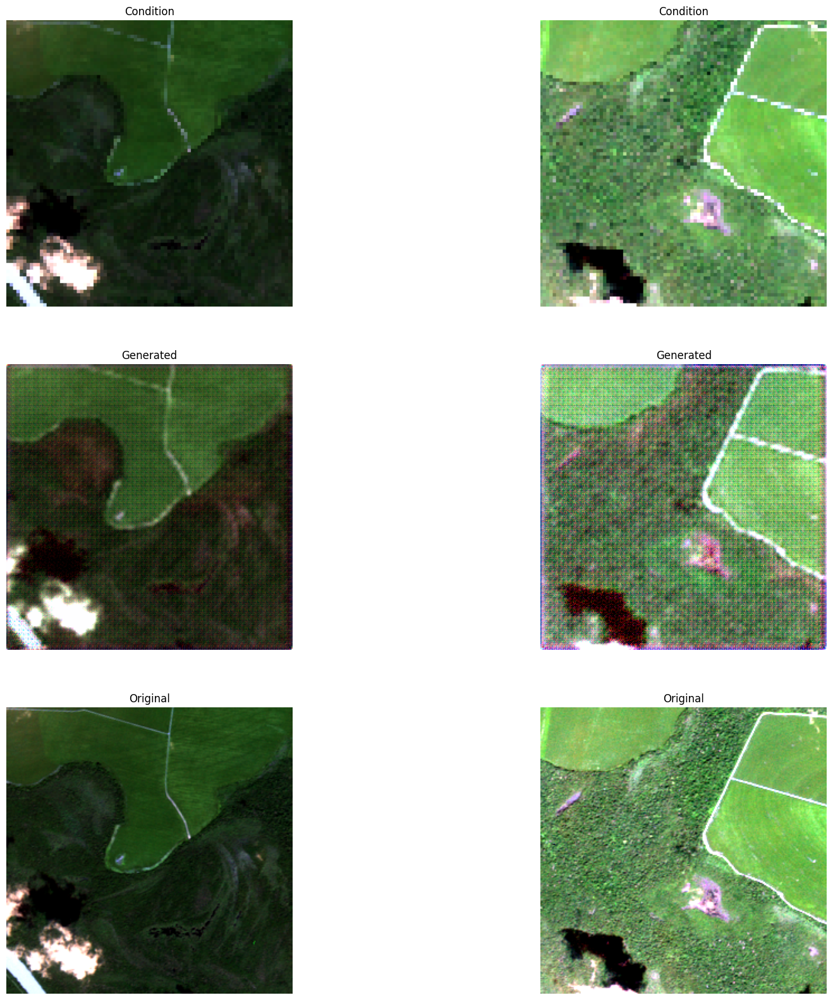

In [ ]:
epoch =7
summarize_performance(epoch, generator, logs_dir, n_samples=2)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


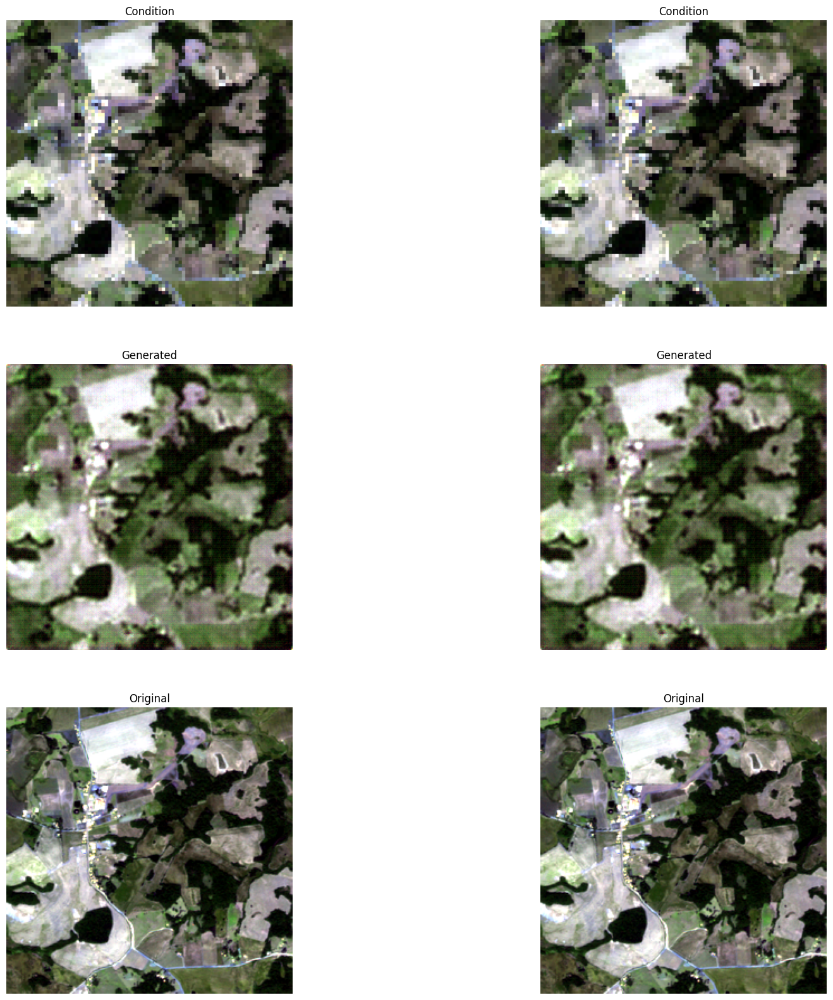

In [ ]:
epoch =73
summarize_performance(epoch, generator, logs_dir, n_samples=2)

In [ ]:
epoch =73
summarize_performance(epoch, generator, logs_dir, n_samples=2)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
